<a href="https://colab.research.google.com/github/romqn1999/Client-Server-Chat-Socket-C-/blob/master/Predict_price_after_pattern.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [2]:
from google.colab import files
uploaded = files.upload()

Saving data_price_patterns_double_bot.zip to data_price_patterns_double_bot.zip


## Import packages

In [3]:
import math
import matplotlib.pyplot as plt
import keras
import numpy as np
import random
import os
import zipfile
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import LSTM
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import *
from tensorflow.keras import optimizers
from tensorflow.keras.optimizers import Adagrad, Adadelta, RMSprop, Adam, SGD
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.utils import to_categorical
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report
from sklearn.metrics import accuracy_score
from scipy import stats

## Get data at pattern for training & testing

In [4]:
#@title Get data
pattern_name = "double_bot" #@param ["double_top", "double_bot"]
import io
import pandas as pd

price_patterns_df = pd.DataFrame()
# for filename in uploaded.keys():
#     print(filename)
#     if 'double_top_data_patterns.csv' not in filename:
#     # if 'data_patterns.csv' not in filename:
#         print('Skipping file', filename)
#         continue
#     try:
#         df = pd.read_csv(io.StringIO(uploaded[filename].decode('utf-8')),
#                         header=None)
#         price_patterns_df = price_patterns_df.append(df)
#     except:
#         print('Error', filename)

# filebytes = io.BytesIO(uploaded['data_price_patterns.zip'])
filebytes = io.BytesIO(uploaded['data_price_patterns_{}.zip'.format(pattern_name)])
myzipfile = zipfile.ZipFile(filebytes)
# for filename in os.listdir('.'):
#     if not os.path.isfile(filename):
#         continue
multi_features_data = []
columns = ['High', 'Low', 'Open', 'Close', 'Volume', 'Adj Close']
for filename in myzipfile.namelist():
    print(filename)
    if (pattern_name == 'double_top' 
        and 'double_top_data_pattern.csv' not in filename) \
        or (pattern_name == 'double_bottom'
        and 'double_bot_data_pattern.csv' not in filename):
    # if 'data_patterns.csv' not in filename:
        print('Skipping file', filename)
        continue
    # try:
    file = myzipfile.open(filename)
    fileread = file.read()
    # print(io.BytesIO(fileread))
    df = pd.read_csv(io.BytesIO(fileread))
    # print(df.head())
    # multi_features_data.append(df.to_numpy())
    multi_features_data.append(df[columns].to_numpy())
    # Plot the time series
    # df.plot(subplots=True,
    #         layout=(6, 3),
    #         figsize=(22,22),
    #         fontsize=10, 
    #         linewidth=2,
    #         sharex=False,
    #         title='Visualization of the original Time Series')
    # plt.show()
    # price_patterns_df = price_patterns_df.append(df)
    y_data = df['Close']
    prices = np.array(y_data).reshape(-1, 1)
    price_patterns_df = price_patterns_df.append(pd.DataFrame(prices).T)
    # except:
    #     print('Error', filename)

multi_features_data = np.array(multi_features_data)
print(multi_features_data)

price_patterns_df = price_patterns_df.sample(frac=1).reset_index(drop=True)
price_patterns_df

Streaming output truncated to the last 5000 lines.
AAIIQ_2000-01-01 00:00:00_2021-06-15_30_085_double_bot_data_pattern.csv
AAIIQ_2000-01-01 00:00:00_2021-06-15_30_086_double_bot_data_pattern.csv
AAIIQ_2000-01-01 00:00:00_2021-06-15_30_087_double_bot_data_pattern.csv
AAIIQ_2000-01-01 00:00:00_2021-06-15_30_088_double_bot_data_pattern.csv
AAIIQ_2000-01-01 00:00:00_2021-06-15_30_089_double_bot_data_pattern.csv
AAIIQ_2000-01-01 00:00:00_2021-06-15_30_090_double_bot_data_pattern.csv
AAIIQ_2000-01-01 00:00:00_2021-06-15_30_091_double_bot_data_pattern.csv
AAIIQ_2000-01-01 00:00:00_2021-06-15_30_092_double_bot_data_pattern.csv
AAIIQ_2000-01-01 00:00:00_2021-06-15_30_093_double_bot_data_pattern.csv
AAIIQ_2000-01-01 00:00:00_2021-06-15_30_094_double_bot_data_pattern.csv
AAIIQ_2000-01-01 00:00:00_2021-06-15_30_095_double_bot_data_pattern.csv
AAIIQ_2000-01-01 00:00:00_2021-06-15_30_096_double_bot_data_pattern.csv
AAIIQ_2000-01-01 00:00:00_2021-06-15_30_097_double_bot_data_pattern.csv
AAIIQ_2000-01

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30
0,24.639999,27.059999,31.350000,29.150000,29.9200,29.260000,29.920000,30.690001,29.590000,30.139999,28.709999,29.370001,28.709999,27.610001,27.280001,26.5100,29.040001,28.049999,27.610001,26.510000,26.400000,26.400000,26.950001,27.280001,27.280001,26.950001,26.620001,28.709999,28.160000,29.260000,28.600000
1,25401.599609,26157.599609,27216.000000,25552.800781,25704.0000,24948.000000,24645.599609,24343.199219,23889.599609,22528.800781,24192.000000,24040.800781,24343.199219,24494.400391,24192.000000,22680.0000,23436.000000,24343.199219,23284.800781,22680.000000,23133.599609,22982.400391,22528.800781,22528.800781,23436.000000,22680.000000,22377.599609,22226.400391,23889.599609,26611.199219,25250.400391
2,4.250000,4.500000,4.000000,4.250000,4.0000,4.500000,4.750000,4.250000,4.250000,4.250000,4.250000,4.500000,4.000000,4.500000,4.500000,4.2500,4.500000,4.250000,4.000000,4.250000,4.250000,4.500000,4.250000,4.250000,4.500000,4.250000,4.250000,4.250000,4.250000,4.500000,4.000000
3,0.000200,0.000200,0.000200,0.000200,0.0001,0.000200,0.000100,0.000100,0.000100,0.000200,0.000150,0.000150,0.000200,0.000200,0.000200,0.0001,0.000150,0.000150,0.000150,0.000200,0.000200,0.000200,0.000200,0.000150,0.000200,0.000100,0.000100,0.000200,0.000100,0.000200,0.000150
4,13.500000,13.500000,13.450000,13.650000,13.4500,13.300000,13.050000,13.150000,12.950000,12.900000,12.750000,12.750000,12.750000,12.600000,12.550000,12.6000,12.550000,12.550000,12.500000,12.650000,13.000000,12.900000,12.950000,13.200000,12.850000,12.950000,13.000000,12.650000,12.850000,14.950000,15.050000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5073,0.000200,0.000200,0.000200,0.000200,0.0002,0.000150,0.000200,0.000100,0.000100,0.000100,0.000100,0.000100,0.000100,0.000150,0.000200,0.0002,0.000200,0.000100,0.000100,0.000200,0.000200,0.000200,0.000200,0.000200,0.000100,0.000200,0.000100,0.000100,0.000100,0.000200,0.000150
5074,15.980000,16.290001,16.780001,17.230000,17.0000,16.860001,16.600000,16.510000,16.650000,16.969999,16.670000,15.740000,15.530000,15.690000,15.720000,15.8400,15.700000,15.780000,16.190001,16.139999,15.590000,16.370001,16.520000,16.100000,16.020000,15.520000,16.299999,16.450001,16.219999,16.590000,16.809999
5075,0.000200,0.000200,0.000200,0.000100,0.0002,0.000200,0.000200,0.000200,0.000100,0.000200,0.000200,0.000200,0.000100,0.000200,0.000100,0.0002,0.000100,0.000100,0.000200,0.000100,0.000200,0.000200,0.000200,0.000200,0.000200,0.000100,0.000100,0.000100,0.000100,0.000200,0.000200
5076,0.170000,0.190000,0.210000,0.190000,0.2200,0.210000,0.210000,0.220000,0.200000,0.190000,0.190000,0.200000,0.210000,0.190000,0.190000,0.2000,0.210000,0.190000,0.190000,0.210000,0.190000,0.190000,0.190000,0.190000,0.190000,0.190000,0.190000,0.190000,0.190000,0.210000,0.220000


In [5]:
n_samples, n_steps, n_features = multi_features_data.shape
multi_features_data_df = pd.DataFrame(
    multi_features_data.reshape(n_samples * n_steps, n_features),
    index=pd.MultiIndex.from_product([range(n_samples), range(n_steps)]),
    columns=columns
)
# panel = pd.Panel(multi_features_data)
# panel.to_frame()
multi_features_data_df

High         Low        Open       Close      Volume   Adj Close
0    0    74.492996   71.152832   73.411652   72.378357   1245402.0   55.995926
     1    71.417160   66.755341   71.369102   70.167603   2022888.0   54.285572
     2    71.104767   67.764603   69.134308   69.110283   1961298.0   53.467579
     3    71.945824   68.701767   71.128799   69.350578   1237911.0   53.653473
     4    70.840439   67.812660   69.446701   67.836693   1226009.0   52.482269
...             ...         ...         ...         ...         ...         ...
5077 26  350.000000  340.339996  345.200012  349.609985   5009200.0  349.609985
     27  349.959991  336.850006  344.980011  337.709991   3360400.0  337.709991
     28  358.899994  331.100006  333.200012  356.809998   8934400.0  356.809998
     29  384.230011  348.651001  360.000000  364.630005  14056500.0  364.630005
     30  384.950012  370.500000  371.000000  383.239990   9311000.0  383.239990

[157418 rows x 6 columns]

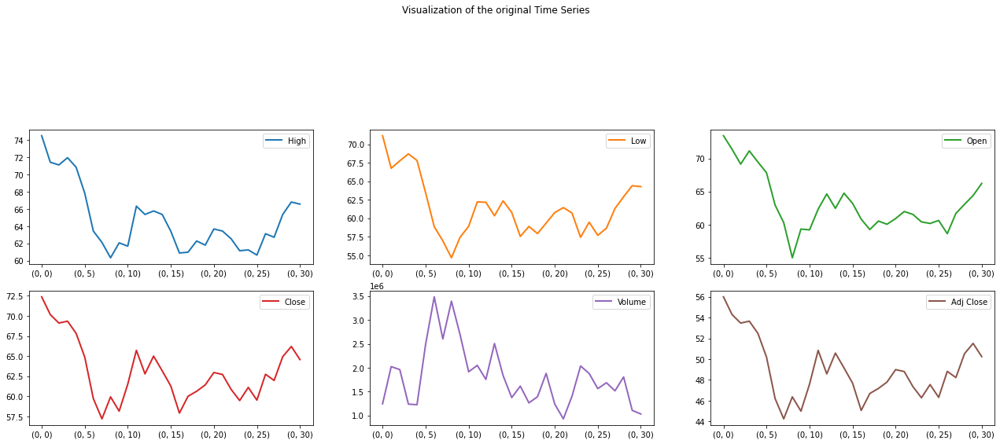

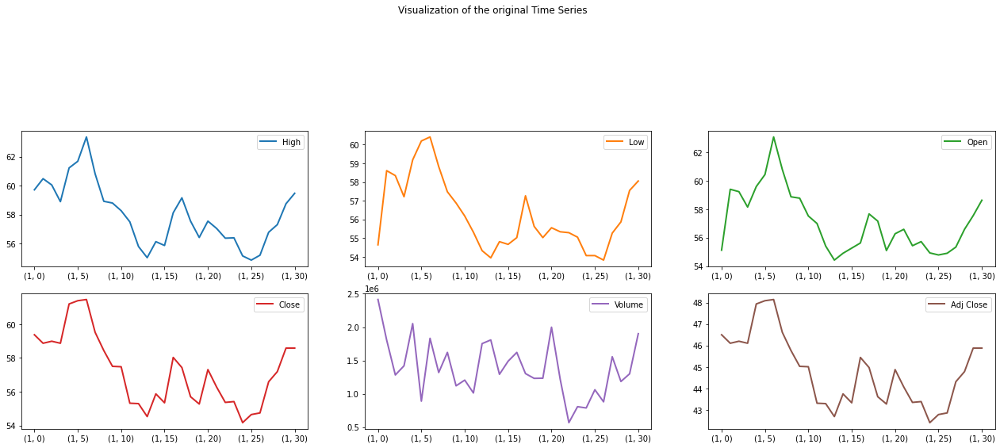

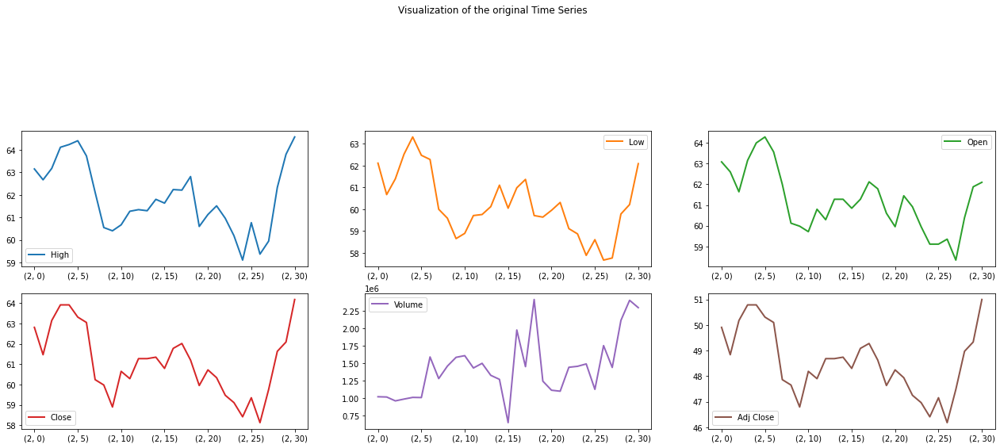

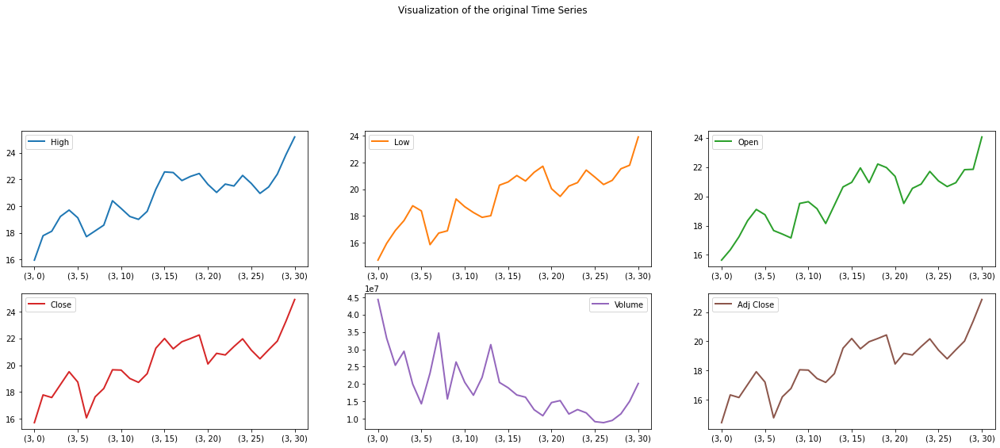

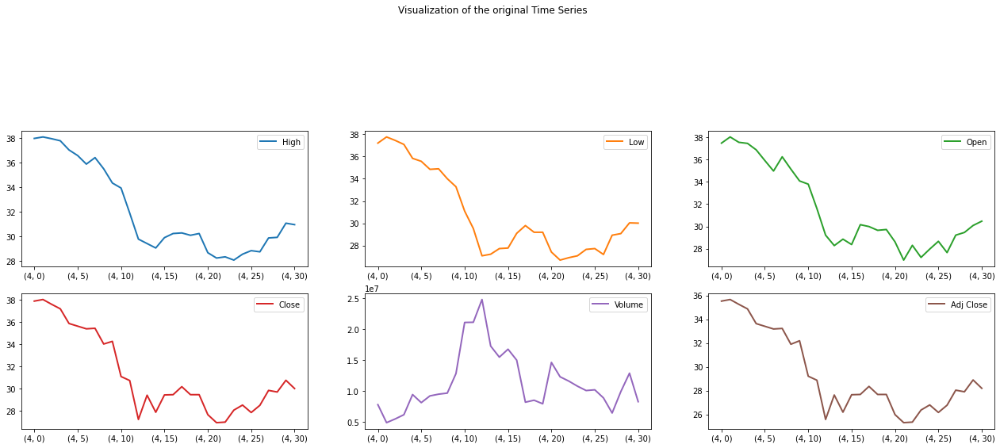

...

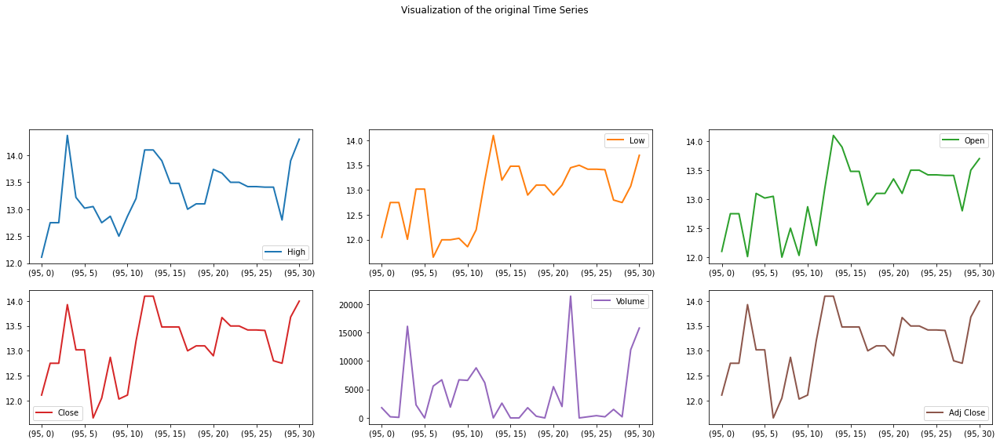

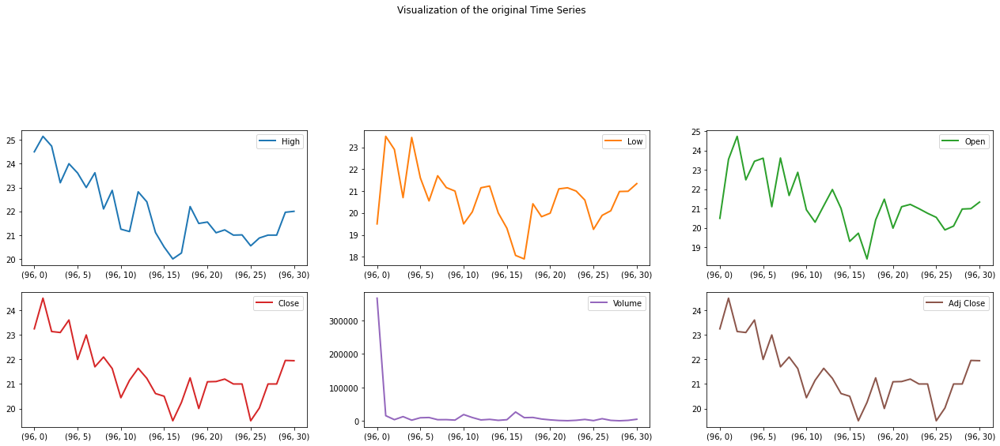

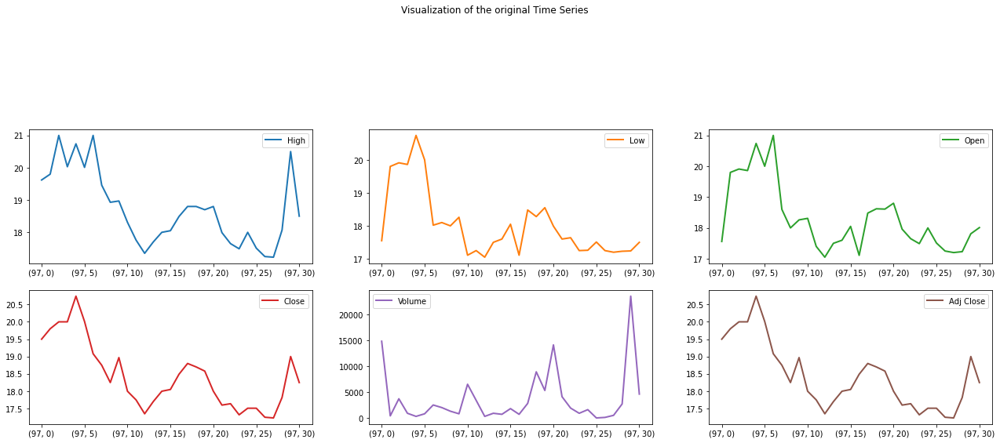

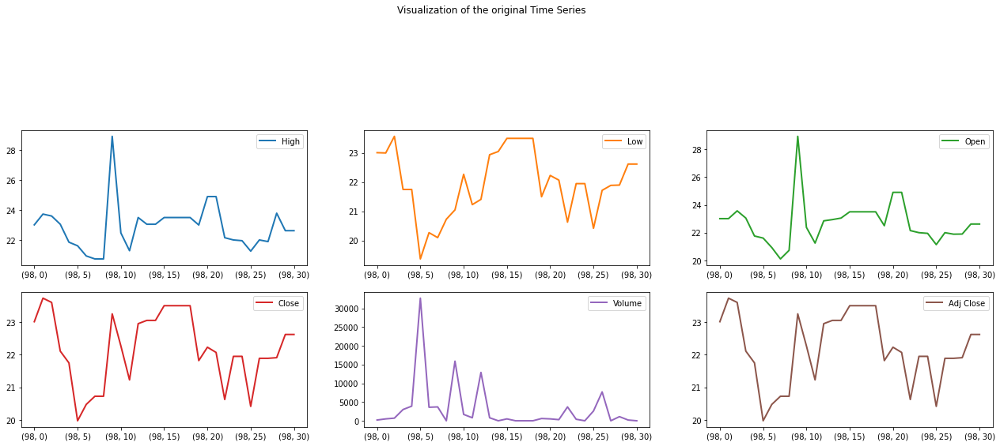

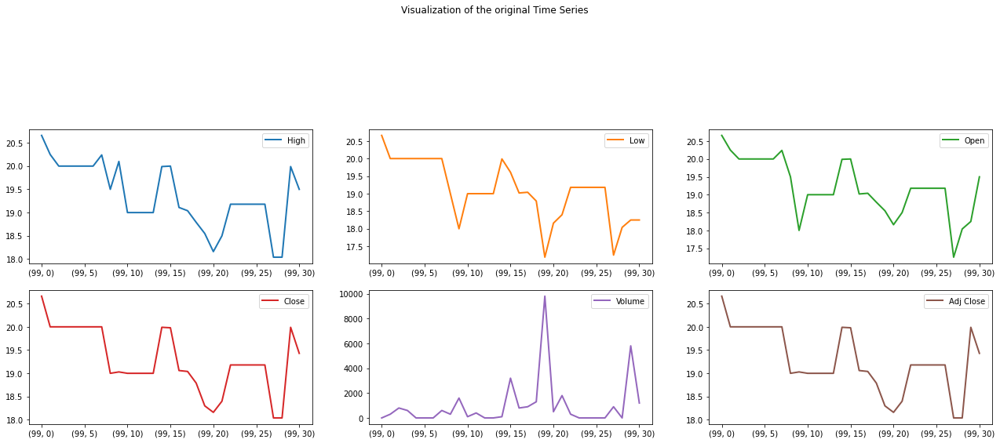

In [6]:
for i in range(min(n_samples, 100)):
    # Plot the time series
    df = multi_features_data_df.loc[pd.IndexSlice[i, range(0, n_steps)], :]
    # df = multi_features_data_df.loc[pd.IndexSlice[i, range(n_steps - (pre_time_steps + 1), n_steps - 1)], :]
    df.plot(subplots=True,
            layout=(6, 3),
            figsize=(22,22),
            fontsize=10, 
            linewidth=2,
            sharex=False,
            title='Visualization of the original Time Series')
    plt.show()

In [7]:
#@title Separate into input and output columns: Get data: X and y
pre_time_steps =  30#@param {type:"integer"}

# X_df = price_patterns_df[price_patterns_df.columns[-(pre_time_steps + 1):-1]]
# y_df = price_patterns_df[price_patterns_df.columns[-1:]]
# X_df = multi_features_data_df.xs(tuple(range(n_steps - (pre_time_steps + 1), n_steps - 1)), level=1, drop_level=False)
# X_df = multi_features_data_df.xs(tuple(i for i in range(29, 30)), level=1, drop_level=False)
# X_df = multi_features_data_df.xs(tuple([28, 29]), level=1, drop_level=False)
X_df = multi_features_data_df.loc[pd.IndexSlice[:, range(n_steps - (pre_time_steps + 1), n_steps - 1)], :]
y_df = multi_features_data_df.xs(n_steps - 1, level=1, drop_level=False)
print(X_df)
print(y_df)

X_data = X_df.values.reshape(n_samples, pre_time_steps, n_features)
# Only predict for 1 step after
y_data = y_df.values.reshape(n_samples, n_features)
# print(X_data)
# print(y_data)

               High         Low        Open       Close      Volume   Adj Close
0    0    74.492996   71.152832   73.411652   72.378357   1245402.0   55.995926
     1    71.417160   66.755341   71.369102   70.167603   2022888.0   54.285572
     2    71.104767   67.764603   69.134308   69.110283   1961298.0   53.467579
     3    71.945824   68.701767   71.128799   69.350578   1237911.0   53.653473
     4    70.840439   67.812660   69.446701   67.836693   1226009.0   52.482269
...             ...         ...         ...         ...         ...         ...
5077 25  354.480011  341.600006  346.000000  342.500000   5601200.0  342.500000
     26  350.000000  340.339996  345.200012  349.609985   5009200.0  349.609985
     27  349.959991  336.850006  344.980011  337.709991   3360400.0  337.709991
     28  358.899994  331.100006  333.200012  356.809998   8934400.0  356.809998
     29  384.230011  348.651001  360.000000  364.630005  14056500.0  364.630005

[152340 rows x 6 columns]
             

## Find patterns func

In [8]:
#@title Find pattern params
#@markdown ### Delta price angle degree from data point to trend line
trend_delta =  15#@param {type:"number"}
#@markdown ### Delta price distance between 2 tops/bottoms
y_delta = 0.15 #@param {type:"number"}
#@markdown ### Min height of pattern
min_height = 0.5 #@param {type:"number"}

In [9]:
#@title Check if data is nearly formed a line

# Get angle of vector ba & vector bc
def get_angle(a, b, c):
    a = np.array(a)
    b = np.array(b)
    c = np.array(c)

    if np.array_equal(a, b) or np.array_equal(a, c) or np.array_equal(b, c):
        return 0

    ba = a - b
    bc = c - b

    if np.all(ba == 0) or np.all(bc == 0):
        return 0

    cosine_angle = np.dot(ba, bc) / (np.linalg.norm(ba) * np.linalg.norm(bc))
    # print(a, b, c)
    # print(cosine_angle)
    angle = np.arccos(cosine_angle)

    deg = np.degrees(angle)
    # print('get_angle({}, {}, {}) = {}'.format(a, b, c, deg))
    return deg

def is_trend(x_data, y_data):
    assert len(x_data) == len(y_data)
    if len(x_data) < 2:
        return False
    # print(x_data)
    # print(y_data)
    # Find the line from the first to the last point
    # y = a * x + b
    x1, y1 = x_data[0], y_data[0]
    x2, y2 = x_data[-1], y_data[-1]
    a = (y1 - y2) / (x1 - x2)  # slope
    b = y1 - a * x1  # intercept
    b_is_trend = True
    for i in range(len(x_data)):
        angle1 = get_angle([x_data[0], y_data[0]], [x_data[-1], y_data[-1]], [x_data[i], y_data[i]])
        angle2 = get_angle([x_data[-1], y_data[-1]], [x_data[0], y_data[0]], [x_data[i], y_data[i]])
        if (angle1 > trend_delta) or (angle2 > trend_delta):
            b_is_trend = False
            break
        # y_val = a * x_data[i] + b
        # err = abs(y_val - y_data[i])
        # if (err > trend_delta * y_val):
        #     b_is_trend = False
        #     break
    return b_is_trend
    # p, res, _, _, _ = np.polyfit(x_data, y_data, 1, full=True)
    # err = res[0] if res.size > 0 else 0
    # if err <= len(x_data) * trend_delta:
    #     return True
    # return False

In [10]:
#@title Find double top func

def find_double_top(x_data, y_data, key_points=None):
    assert len(x_data) == len(y_data)
    if key_points is None:        
        #           ___ detection of local minimums and maximums ___
        min_max = np.diff(np.sign(np.diff(y_data))).nonzero()[0] + 1          # local min & max
        l_min = (np.diff(np.sign(np.diff(y_data))) > 0).nonzero()[0] + 1      # local min
        l_max = (np.diff(np.sign(np.diff(y_data))) < 0).nonzero()[0] + 1      # local max
        # +1 due to the fact that diff reduces the original index number
        key_points = min_max
        # print(key_points)

    suspected_double_tops = list()
    n = len(x_data)
    maxy = np.max(y_data)
    # for i in range(1, n - 3):
    #     for j in range(i + 2, n - 1):
    for i in range(1, len(key_points) - 2):
        for j in range(i + 2, len(key_points)):
            l = key_points[i]
            r = key_points[j]
            # print(l, r, abs(y_data[l] - y_data[r]))
            # if l == 301 and r == 307:
            #     print(y_data[l], y_data[r], max(y_data[key_points[i + 1: j]]))
            if (abs(y_data[l] - y_data[r]) <= y_delta * maxy) \
               and r - l > 1 \
               and min(y_data[l], y_data[r]) >= max(y_data[key_points[i + 1: j]]):
                k_bottom = np.argmin(y_data[l + 1: r]) + l + 1
                # print(l, k_bottom, r)
                if min(y_data[l], y_data[r]) < y_data[k_bottom] + min_height:
                    continue
                (ilows,) = np.where(y_data[:l] <= y_data[k_bottom])
                istart = None
                if ilows.size > 0:
                    istart = ilows[-1]
                (ilows,) = np.where(y_data[r:] <= y_data[k_bottom])
                iend = None
                if ilows.size > 0:
                    iend = ilows[0] + r
                # print(istart, l, k_bottom, r, iend)
                if istart and iend \
                   and is_trend(x_data[istart: l + 1], y_data[istart:l + 1]) \
                   and is_trend(x_data[l: k_bottom + 1], y_data[l: k_bottom + 1]) \
                   and is_trend(x_data[k_bottom: r + 1], y_data[k_bottom: r + 1]) \
                   and is_trend(x_data[r: iend + 1], y_data[r: iend + 1]):                    
                    suspected_double_tops.append((istart, l, k_bottom, r, iend))
    return suspected_double_tops

In [11]:
#@title Find double bottom func

def find_double_bottom(x_data, y_data, key_points=None):
    assert len(x_data) == len(y_data)
    if key_points is None:        
        #           ___ detection of local minimums and maximums ___
        min_max = np.diff(np.sign(np.diff(y_data))).nonzero()[0] + 1          # local min & max
        l_min = (np.diff(np.sign(np.diff(y_data))) > 0).nonzero()[0] + 1      # local min
        l_max = (np.diff(np.sign(np.diff(y_data))) < 0).nonzero()[0] + 1      # local max
        # +1 due to the fact that diff reduces the original index number
        key_points = min_max

    suspected_double_bottoms = list()
    n = len(x_data)
    maxy = np.max(y_data)
    # for i in range(1, n - 3):
    #     for j in range(i + 2, n - 1):
    for i in range(1, len(key_points) - 2):
        for j in range(i + 2, len(key_points)):
            l = key_points[i]
            r = key_points[j]
            if (abs(y_data[l] - y_data[r]) <= y_delta * maxy) \
               and r - l > 1 \
               and max(y_data[l], y_data[r]) <= min(y_data[key_points[i + 1: j]]):
                k_top = np.argmax(y_data[l + 1: r]) + l + 1
                if max(y_data[l], y_data[r]) + min_height > y_data[k_top]:
                    continue
                (ihights,) = np.where(y_data[:l] >= y_data[k_top])
                istart = None
                if ihights.size > 0:
                    istart = ihights[-1]
                (ihights,) = np.where(y_data[r:] >= y_data[k_top])
                iend = None
                if ihights.size > 0:
                    iend = ihights[0] + r
                if istart and iend \
                   and is_trend(x_data[istart: l + 1], y_data[istart: l + 1]) \
                   and is_trend(x_data[l: k_top + 1], y_data[l: k_top + 1]) \
                   and is_trend(x_data[k_top: r + 1], y_data[k_top: r + 1]) \
                   and is_trend(x_data[r: iend + 1], y_data[r: iend + 1]):                    
                    suspected_double_bottoms.append((istart, l, k_top, r, iend))
    return suspected_double_bottoms

In [12]:
#@title Visualize result func

def visualize_res(x_data, y_data, suspected_double_tops=[], suspected_double_bottoms=[]):
    # ___ plotting ___
    plt.figure(figsize=(20, 10), dpi= 120, facecolor='w', edgecolor='k')
    # plot stock data
    plt.plot(x_data, y_data, '-', markersize=1.5, color='magenta', alpha=0.7)
    plt.axis('equal')

    for istart, top1, bottom, top2, iend in suspected_double_tops:
        plt.plot(x_data[istart], y_data[istart], "o", color='r')
        plt.plot(x_data[top1], y_data[top1], "o", color='b')
        plt.plot(x_data[bottom], y_data[bottom], "o", color='g')
        plt.plot(x_data[top2], y_data[top2], "o", color='b')
        plt.plot(x_data[iend], y_data[iend], "o", color='r')
        plt.plot(np.array(x_data)[[istart, top1, bottom, top2, iend]], np.array(y_data)[[istart, top1, bottom, top2, iend]], "-", color='g')

    for istart, bot1, top, bot2, iend in suspected_double_bottoms:
        plt.plot(np.array(x_data)[[istart, bot1, top, bot2, iend]], np.array(y_data)[[istart, bot1, top, bot2, iend]], "-", color='b')

    plt.show()

def visualize_pred(X, y_true, y_pred):
    # ___ plotting ___
    plt.figure(figsize=(20, 10), dpi= 120, facecolor='w', edgecolor='k')
    # plot stock data
    n_days_X = len(X)
    n_days_y = len(y_true)
    days = np.array(range(n_days_X + n_days_y))
    # print(days[:n_days_X])
    # print(days[-n_days_y:])
    plt.plot(days[:n_days_X], X, '-', markersize=1.5, color='magenta')
    plt.plot(days[-(n_days_y + 1):], [X[-1], y_true], '-', markersize=1.5, color='red')
    plt.plot(days[-(n_days_y + 1):], [X[-1], y_pred], '-', markersize=1.5, color='blue')
    # plt.axis('equal')

    plt.show()

In [13]:
# i_debug = 1
# for i, row in enumerate(X_data):
#     # if i < i_debug: continue
#     # if i > i_debug: break
#     # x = np.array(range(len(row)))
#     # y = row.to_numpy()
#     # print(x, y)
#     # print(is_trend(x[8:20], y[8:20]))
#     double_tops = find_double_top(range(len(row)), row)
#     double_bots = find_double_bottom(range(len(row)), row)
#     print(i, double_tops, double_bots)
#     visualize_res(range(len(row)), row, double_tops, double_bots)

## Preprocess & split data

In [14]:
def get_direction(pre, cur, min_change=1):
    if abs(pre - cur) < min_change:
        return 0
    else:
        if pre < cur:
            return 1
        else:
            return -1

def get_binary_direction(pre, cur, min_change=0):
    d = get_direction(pre, cur, min_change)
    if d < 1:
        d = 0
    return d

def y_preice_to_y_label(X, y, feature_pred_idx=0, min_change=0, num_classes=2):
    # print(X.shape, y.shape)
    assert len(X) == len(y)
    # print(feature_pred_idx)
    n = len(y)
    feature_pred_idx_y = min(feature_pred_idx, y.shape[-1] - 1)
    if num_classes <= 2:
        y_label = np.array([get_binary_direction(X[i][-1][feature_pred_idx], y[i][feature_pred_idx_y], min_change) for i in range(n)])
    else:
        y_label = np.array([get_direction(X[i][-1][feature_pred_idx], y[i][feature_pred_idx_y], min_change) for i in range(n)])
        # Convert from {-1; 0; 1} to label {0; 1; 2}
        y_label = y_label + 1
    return y_label

In [15]:
#@title Preprocess & split data for train model
# Train, test split
train_ratio = 0.8 #@param {type:"number"}
val_ratio = 0.1 #@param {type:"number"}
if train_ratio < 0 or  train_ratio > 1:
    train_ratio = 0.8
val_ratio = min(val_ratio, 1 - train_ratio)
test_ratio = 1 - train_ratio - val_ratio
# Feature Scaling
scale_method = "MinMax" #@param ["None", "MinMax", "StandardScaler"]
min_price_change = 0 #@param {type:"number"}
num_classes = 2 #@param {type:"integer"}
feature_pred = "Close" #@param {type:"string"}
train_multi_features = False #@param {type:"boolean"}
feature_pred_idx = columns.index(feature_pred)
# print(feature_pred_idx)

if not train_multi_features:
    X_data, y_data = X_data[:, :, feature_pred_idx], y_data[:, feature_pred_idx]
    X_data = X_data.reshape(X_data.shape[0], X_data.shape[1], 1)
    y_data = y_data.reshape(-1, 1)
    # X_train, y_train = X_train[:, :, feature_pred_idx], y_train[:, feature_pred_idx]
    # X_train = X_train.reshape(X_train.shape[0], X_train.shape[1], 1)
    # y_train = y_train.reshape(-1, 1)
    # X_test, y_test = X_test[:, :, feature_pred_idx], y_test[:, feature_pred_idx]
    # X_test = X_test.reshape(X_test.shape[0], X_test.shape[1], 1)
    # y_test = y_test.reshape(-1, 1)
    feature_pred_idx = 0

# X_train, X_test, y_train, y_test = train_test_split(X_data, y_data, train_size=train_ratio, random_state=7)
n_data = len(X_data)
n_train = int(train_ratio * n_data)
X_train, y_train = X_data[: n_train], y_data[: n_train]
if test_ratio > 0:
    n_val = int(val_ratio * n_data)
    n_test = n_data - n_train - n_val
    X_val, y_val = X_data[n_train: n_train + n_val], y_data[n_train: n_train + n_val]
    X_test, y_test = X_data[n_train + n_val:], y_data[n_train + n_val:]
else:
    n_val = n_data - n_train
    # Use val set for testing
    n_test = n_data - n_train
    X_val, y_val = X_data[n_train:], y_data[n_train:]
    X_test, y_test = X_data[n_train:], y_data[n_train:]

if scale_method != 'None':
    if scale_method == 'MinMax':
        sc_train = MinMaxScaler(feature_range = (0, 1))
        sc_val = MinMaxScaler(feature_range = (0, 1))
        sc_test = MinMaxScaler(feature_range = (0, 1))
    else:
        sc_train = StandardScaler()
        sc_val = StandardScaler()
        sc_test = StandardScaler()
    # X_train_scaled = sc_train.fit_transform(X_train.T).T
    # X_test_scaled = sc_test.fit_transform(X_test.T).T
    # y_train_scaled = sc_train.transform(y_train.T).T
    # y_test_scaled = sc_test.transform(y_test.T).T
    X_train_scaled = sc_train.fit_transform(X_train.reshape(X_train.shape[0], -1).T).T.reshape(X_train.shape)
    y_train_scaled = sc_train.transform(y_train.T).T
    # X_train_scaled = sc_train.fit_transform(X_train.reshape(-1, X_train.shape[-1])).reshape(X_train.shape)
    # y_train_scaled = sc_train.transform(y_train)
    X_val_scaled = sc_val.fit_transform(X_val.reshape(X_val.shape[0], -1).T).T.reshape(X_val.shape)
    y_val_scaled = sc_val.transform(y_val.T).T
    # X_val_scaled = sc_val.fit_transform(X_val.reshape(-1, X_val.shape[-1])).reshape(X_val.shape)
    # y_val_scaled = sc_val.transform(y_val)
    X_test_scaled = sc_test.fit_transform(X_test.reshape(X_test.shape[0], -1).T).T.reshape(X_test.shape)
    y_test_scaled = sc_test.transform(y_test.T).T
    # X_test_scaled = sc_test.fit_transform(X_test.reshape(-1, X_test.shape[-1])).reshape(X_test.shape)
    # y_test_scaled = sc_test.transform(y_test)

    y_train_scaled = y_train_scaled[:, feature_pred_idx]
    y_train_scaled = y_train_scaled.reshape(-1, 1)
    y_val_scaled = y_val_scaled[:, feature_pred_idx]
    y_val_scaled = y_val_scaled.reshape(-1, 1)
    y_test_scaled = y_test_scaled[:, feature_pred_idx]
    y_test_scaled = y_test_scaled.reshape(-1, 1)

    print(X_train_scaled.shape, y_train_scaled.shape)
    print('Stats y_train_scaled:', stats.describe(y_train_scaled))
    print(X_val_scaled.shape, y_val_scaled.shape)
    print('Stats y_val_scaled:', stats.describe(y_val_scaled))
    print(X_test_scaled.shape, y_test_scaled.shape)
    print('Stats y_test_scaled:', stats.describe(y_test_scaled))

    # X_train, y_train = X_train_scaled, y_train_scaled
    # y_train_label, y_train_categorical = y_train_scaled_label, y_train_scaled_categorical
    # X_test, y_test = X_test_scaled, y_test_scaled
    # y_test_label, y_test_categorical = y_test_scaled_label, y_test_scaled_categorical

y_train = y_train[:, feature_pred_idx]
y_train = y_train.reshape(-1, 1)
y_val = y_val[:, feature_pred_idx]
y_val = y_val.reshape(-1, 1)
y_test = y_test[:, feature_pred_idx]
y_test = y_test.reshape(-1, 1)

print(X_train.shape, y_train.shape)
print('Stats y_train:', stats.describe(y_train))
print(X_val.shape, y_val.shape)
print('Stats y_val:', stats.describe(y_val))
print(X_test.shape, y_test.shape)
print('Stats y_test:', stats.describe(y_test))

# print(X_train)
# print(y_train)
# print(y_train_label)
# print(y_train_categorical)

(4062, 30, 1) (4062, 1)
Stats y_train_scaled: DescribeResult(nobs=4062, minmax=(array([-2.98718072]), array([5.51515259])), mean=array([0.6064298]), variance=array([0.20251973]), skewness=array([0.96755568]), kurtosis=array([9.26592153]))
(507, 30, 1) (507, 1)
Stats y_val_scaled: DescribeResult(nobs=507, minmax=(array([-0.38970344]), array([1.78260922])), mean=array([0.54584762]), variance=array([0.1733063]), skewness=array([0.44324733]), kurtosis=array([-0.49576067]))
(509, 30, 1) (509, 1)
Stats y_test_scaled: DescribeResult(nobs=509, minmax=(array([-0.32978715]), array([1.81132011])), mean=array([0.63041903]), variance=array([0.11756554]), skewness=array([0.34728665]), kurtosis=array([0.50758575]))
(4062, 30, 1) (4062, 1)
Stats y_train: DescribeResult(nobs=4062, minmax=(array([9.99999975e-06]), array([1893780.])), mean=array([1164.85755336]), variance=array([1.06356474e+09]), skewness=array([50.719382]), kurtosis=array([2838.86383299]))
(507, 30, 1) (507, 1)
Stats y_val: DescribeResu

In [16]:
# i_debug = 1
# for i, row in enumerate(X_test):
#     # if i < i_debug: continue
#     # if i > i_debug: break
#     # x = np.array(range(len(row)))
#     # y = row.to_numpy()
#     # print(x, y)
#     # print(is_trend(x[8:20], y[8:20]))
#     double_tops = find_double_top(range(len(row)), row)
#     double_bots = find_double_bottom(range(len(row)), row)
#     print(i, double_tops, double_bots)
#     visualize_res(range(len(row)), row, double_tops, double_bots)

## LSTM model

### Build model

In [248]:
#@title Build & fit model
lstm_units = 50 #@param {type:"integer"}
dropout_prob = 0.2 #@param {type:"number"}
epochs = 10000 #@param {type:"integer"}
batch_size = 32768 #@param {type:"integer"}
lr = 0.0001 #@param {type:"number"}
early_stopping_epochs = 1000 #@param {type:"number"}



### Train model

Streaming output truncated to the last 5000 lines.
1/1 [==============================] - 0s 64ms/step - loss: 0.1817 - val_loss: 0.1415
Epoch 1006/10000
1/1 [==============================] - 0s 72ms/step - loss: 0.1815 - val_loss: 0.1415
Epoch 1007/10000
1/1 [==============================] - 0s 62ms/step - loss: 0.1804 - val_loss: 0.1416
Epoch 1008/10000
1/1 [==============================] - 0s 72ms/step - loss: 0.1812 - val_loss: 0.1416
Epoch 1009/10000
1/1 [==============================] - 0s 63ms/step - loss: 0.1813 - val_loss: 0.1416
Epoch 1010/10000
1/1 [==============================] - 0s 66ms/step - loss: 0.1809 - val_loss: 0.1416
Epoch 1011/10000
1/1 [==============================] - 0s 70ms/step - loss: 0.1811 - val_loss: 0.1416
Epoch 1012/10000
1/1 [==============================] - 0s 72ms/step - loss: 0.1811 - val_loss: 0.1416
Epoch 1013/10000
1/1 [==============================] - 0s 65ms/step - loss: 0.1810 - val_loss: 0.1415
Epoch 1014/10000
1/1 [=================

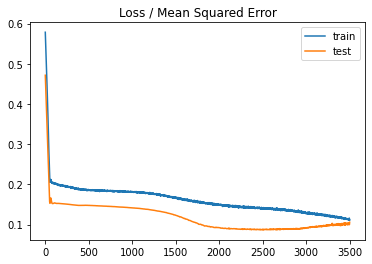

INFO:tensorflow:Assets written to: /content/drive/MyDrive/PredictPriceByPattern/LSTM_double_bot_best_val_loss/assets


INFO:tensorflow:Assets written to: /content/drive/MyDrive/PredictPriceByPattern/LSTM_double_bot_best_val_loss/assets


In [249]:
def train_lstm(X_train, y_train, X_test, y_test, lstm_units=50, dropout_prob=0.5, n_features=1, epochs=6000, batch_size=32768, lr=0.001, early_stopping_epochs=100):
    # We have now reshaped the data into the following format (#values, #time-steps, #1 dimensional output).
    X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], n_features))
    y_train = np.reshape(y_train, (y_train.shape[0], 1))
    X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], n_features))
    y_test = np.reshape(y_test, (y_test.shape[0], 1))

    model = Sequential()
    #Adding the first LSTM layer and some Dropout regularisation
    model.add(LSTM(units=lstm_units,
                return_sequences=True,
                input_shape=(X_train.shape[1], X_train.shape[2])))
    model.add(Dropout(dropout_prob))
    # Adding a second LSTM layer and some Dropout regularisation
    model.add(LSTM(units=lstm_units,
                return_sequences=True))
    model.add(Dropout(dropout_prob))
    # # Adding a third LSTM layer and some Dropout regularisation
    # model.add(LSTM(units=lstm_units,
    #             return_sequences=True))
    # model.add(Dropout(dropout_prob))
    # Adding a fourth LSTM layer and some Dropout regularisation
    model.add(LSTM(units=lstm_units))
    model.add(Dropout(dropout_prob))
    # Adding the output layer
    model.add(Dense(units=1))

    # Adam optimizer
    opt = Adam(learning_rate=lr)
    # opt = Adam(learning_rate=lr, epsilon=1e-06, decay=1e-06)
    # # PiecewiseConstantDecay optimizer
    # boundaries = [200, 800, 2000, 4000]
    # values = [0.01, 0.001, 0.0005, 0.0001, 0.00001]
    # opt = keras.optimizers.schedules.PiecewiseConstantDecay(
    #     boundaries, values)

    # checkpoint = ModelCheckpoint("/content/drive/MyDrive/PredictPriceByPattern/LSTM_double_top_best_val_loss", monitor='val_loss', verbose=2,
    #                              save_best_only=True, mode='auto')
    callbacks = [
        # keras.callbacks.ModelCheckpoint(
        #     "/content/drive/MyDrive/PredictPriceByPattern/LSTM_{}_best_val_loss".format(pattern_name),
        #     save_best_only=True,
        #     monitor="val_loss"
        # ),
        keras.callbacks.ReduceLROnPlateau(
            monitor="val_loss", factor=0.5, patience=20, min_lr=0.0001
        ),
        keras.callbacks.EarlyStopping(
            monitor="val_loss",
            patience=early_stopping_epochs,
            verbose=1,
            restore_best_weights=True),
    ]

    def get_lr_metric(optimizer):
        def lr(y_true, y_pred):
            return optimizer._decayed_lr(tf.float32) # I use ._decayed_lr method instead of .lr
        return lr

    lr_metric = get_lr_metric(opt)

    # Compiling the model
    # model.compile(optimizer=opt,
    #               loss=tf.keras.losses.MeanAbsolutePercentageError())
    model.compile(loss='mean_squared_error', optimizer=opt)
    # model.compile(optimizer = 'adam', loss = 'mean_squared_error')
    model.summary()

    tf.keras.utils.plot_model(model, to_file='model.png', show_shapes=True)

    # Fitting the model to the Training set
    history = model.fit(X_train, y_train,
                        validation_data=(X_test, y_test),
                        shuffle=True,
                        epochs=epochs, batch_size=batch_size,
                        callbacks=callbacks)

    # evaluate the model
    train_mse = model.evaluate(X_train, y_train)
    test_mse = model.evaluate(X_test, y_test)
    print('Train: %.3f, Test: %.3f' % (train_mse, test_mse))
    # plot loss during training
    plt.title('Loss / Mean Squared Error')
    plt.plot(history.history['loss'], label='train')
    plt.plot(history.history['val_loss'], label='test')
    plt.legend()
    plt.show()

    return model

if scale_method != 'None':
    model = train_lstm(X_train_scaled, y_train_scaled,
                       X_val_scaled, y_val_scaled,
                       lstm_units=lstm_units, dropout_prob=dropout_prob,
                       n_features=X_train_scaled.shape[-1],
                       epochs=epochs, batch_size=batch_size, lr=lr,
                       early_stopping_epochs=early_stopping_epochs)
else:
    model = train_lstm(X_train, y_train,
                       X_val, y_val,
                       lstm_units=lstm_units, dropout_prob=dropout_prob,
                       n_features=X_train.shape[-1],
                       epochs=epochs, batch_size=batch_size, lr=lr,
                       early_stopping_epochs=early_stopping_epochs)
# model = train_lstm(X_train_scaled, y_train_scaled, X_test_scaled, y_test_scaled, lstm_units, dropout_prob, epochs, batch_size)
model.save('/content/drive/MyDrive/PredictPriceByPattern/LSTM_{}_best_val_loss'.format(pattern_name))

### Test model

In [250]:
def get_direction(pre, cur, min_change=1):
    if abs(pre - cur) < min_change:
        return 0
    else:
        if pre < cur:
            return 1
        else:
            return -1

In [251]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import accuracy_score

def calc_confusion_matrix(X, y_true, y_pred, min_change=1):
    y_true_label = y_preice_to_y_label(X, y_true,
                                       min_change=min_price_change,
                                       feature_pred_idx=feature_pred_idx,
                                       num_classes=num_classes)
    y_pred_label = y_preice_to_y_label(X, y_pred,
                                       min_change=min_price_change,
                                       feature_pred_idx=feature_pred_idx,
                                       num_classes=num_classes)
    labels = list(range(num_classes))
    # print(labels)
    cm = confusion_matrix(y_true_label, y_pred_label, labels=labels)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                                  display_labels=labels)
    disp.plot(cmap=plt.cm.Blues,
              values_format='')
    return cm

def calc_accuracy(X, y_true, y_pred, min_change=1):
    y_true_label = y_preice_to_y_label(X, y_true,
                                       min_change=min_price_change,
                                       feature_pred_idx=feature_pred_idx,
                                       num_classes=num_classes)
    y_pred_label = y_preice_to_y_label(X, y_pred,
                                       min_change=min_price_change,
                                       feature_pred_idx=feature_pred_idx,
                                       num_classes=num_classes)
    return accuracy_score(y_true_label, y_pred_label)

def calc_profit(prev_price, price, action, min_change=0, num_classes=2):
    if num_classes == 2:
        price_direction = get_binary_direction(prev_price, price)
    else:
        price_direction = get_direction(prev_price, price)
    profit = abs(prev_price - price)
    if action != price_direction:
        profit *= -1
    profit_margin = (prev_price + profit) / prev_price
    return profit, profit_margin

def calc_profit_multiple(X, y_true, y_pred_label, min_change=0):
    return np.array([calc_profit(X[i, -1], y_true[i], y_pred_label[i], min_change) for i in range(len(y_pred_label))])

In [252]:
# X_test = X_train
lstm_model = keras.models.load_model("/content/drive/MyDrive/PredictPriceByPattern/LSTM_{}_best_val_loss".format(pattern_name))

In [253]:
if scale_method != 'None':
    predicted_stock_price = lstm_model.predict(X_test_scaled)
    predicted_stock_price = sc_test.inverse_transform(predicted_stock_price.T).T
else:
    predicted_stock_price = lstm_model.predict(X_test)
# predicted_stock_price = lstm_model.predict(np.reshape(X_test_scaled, (X_test_scaled.shape[0], X_test_scaled.shape[1], 1)))
# if scale_method == 'MinMax':
#     predicted_stock_price = sc_test.inverse_transform(predicted_stock_price.T).T
    # y_test = sc_test.inverse_transform(y_test.T).T

In [254]:
# print(y_test)
# print(predicted_stock_price)

In [255]:
float_formatter = "{:.6f}".format
np.set_printoptions(formatter={'float_kind':float_formatter})
# print(y_test - predicted_stock_price)
# print(max(abs(y_test - predicted_stock_price)))
stats.describe(y_test - predicted_stock_price)

DescribeResult(nobs=509, minmax=(array([-631.820312]), array([47.367035])), mean=array([-4.313312]), variance=array([1699.604528]), skewness=array([-11.278124]), kurtosis=array([141.216263]))

In [256]:
y_pred_label = y_preice_to_y_label(X_test, predicted_stock_price,
                                   min_change=min_price_change,
                                   feature_pred_idx=feature_pred_idx,
                                   num_classes=num_classes)
profit_multiple_pred_res = calc_profit_multiple(X_test, y_test, y_pred_label, min_price_change)
profit_multiple_pred = profit_multiple_pred_res[:, 0]
profit_margin_multiple_pred = profit_multiple_pred_res[:, 1]

if pattern_name == 'double_bot':
    y_rush_label = np.zeros(y_pred_label.shape)
else:
    y_rush_label = np.ones(y_pred_label.shape)
profit_multiple_rush_res = calc_profit_multiple(X_test, y_test, y_rush_label, min_price_change)
profit_multiple_rush = profit_multiple_rush_res[:, 0]
profit_margin_multiple_rush = profit_multiple_rush_res[:, 1]

print(stats.describe(profit_multiple_pred))
print(stats.describe(profit_margin_multiple_pred))
print(stats.describe(profit_multiple_rush))
print(stats.describe(profit_margin_multiple_rush))

DescribeResult(nobs=509, minmax=(array([-103.959961]), array([637.464844])), mean=array([1.931147]), variance=array([1026.396833]), skewness=array([16.266596]), kurtosis=array([308.043326]))
DescribeResult(nobs=509, minmax=(array([0.651043]), array([1.516129])), mean=array([1.014158]), variance=array([0.006598]), skewness=array([2.889345]), kurtosis=array([17.141422]))
DescribeResult(nobs=509, minmax=(array([-187.792969]), array([637.464844])), mean=array([0.626432]), variance=array([1029.740314]), skewness=array([14.464160]), kurtosis=array([308.816081]))
DescribeResult(nobs=509, minmax=(array([0.500000]), array([1.516129])), mean=array([1.013813]), variance=array([0.006608]), skewness=array([1.329873]), kurtosis=array([18.196798]))


rmse: 41.41098990819078 mape: 4.918479346692728
confusion_matrix: [[193 122]
 [107  87]]
acc: 0.550098231827112


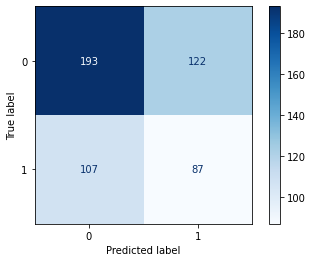

In [257]:
# Calculate RMSE and MAPE
from sklearn.metrics import mean_squared_error
from tensorflow.keras.metrics import mean_absolute_percentage_error

def get_mape(y_true, y_pred): 
    """
    Compute mean absolute percentage error (MAPE)
    """
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

rmse = math.sqrt(mean_squared_error(y_test, predicted_stock_price))
# mape = mean_absolute_percentage_error(y_test.reshape(-1), predicted_stock_price.reshape(-1))
mape = get_mape(y_test, predicted_stock_price)
conf_matrix = calc_confusion_matrix(X_test, y_test, predicted_stock_price, min_price_change)
acc = calc_accuracy(X_test, y_test, predicted_stock_price, min_price_change)

print('rmse:', rmse, 'mape:', mape)
print('confusion_matrix:', conf_matrix)
print('acc:', acc)

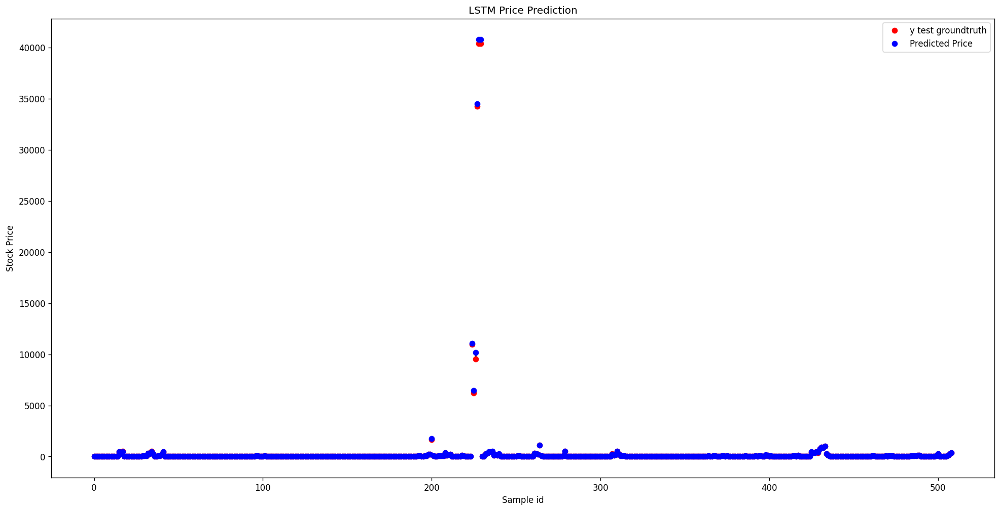

In [258]:
# Visualising the results
plt.figure(figsize=(20, 10), dpi= 120, facecolor='w', edgecolor='k')
plt.plot(range(len(y_test)), y_test, 'o', color = 'red', label = 'y test groundtruth')
plt.plot(range(len(y_test)), predicted_stock_price, 'o', color = 'blue', label = 'Predicted Price')
plt.vlines(range(len(y_test)), np.minimum(y_test, predicted_stock_price), np.maximum(y_test, predicted_stock_price))
# plt.xticks(np.arange(0,459,50))
plt.title('LSTM Price Prediction')
plt.xlabel('Sample id')
plt.ylabel('Stock Price')
plt.legend()
plt.show()

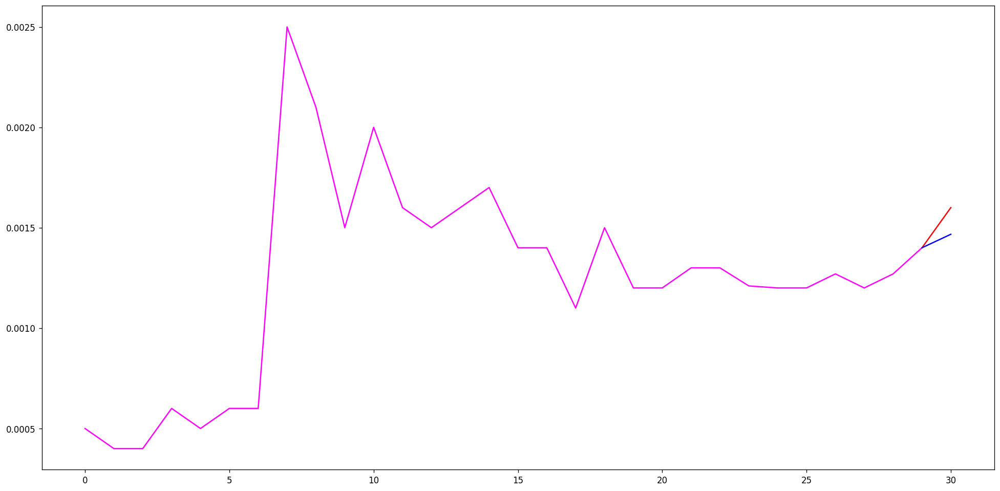

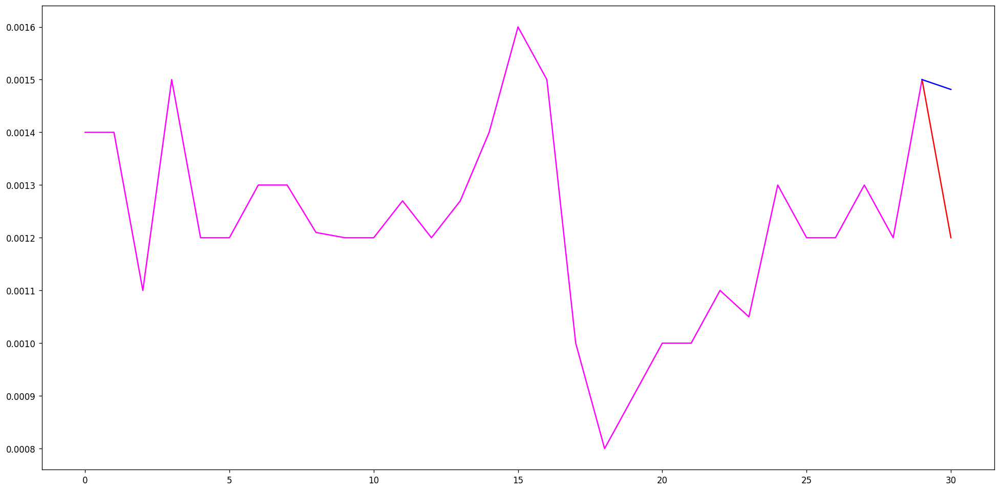

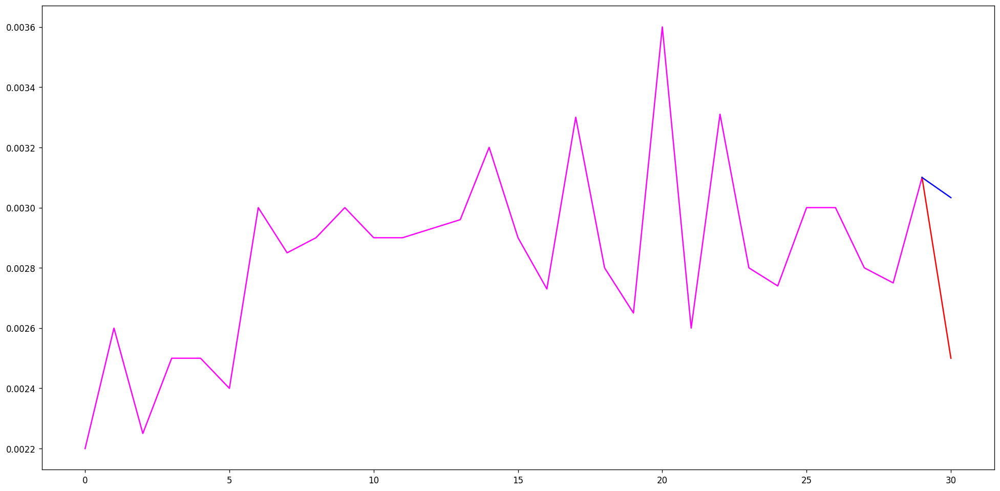

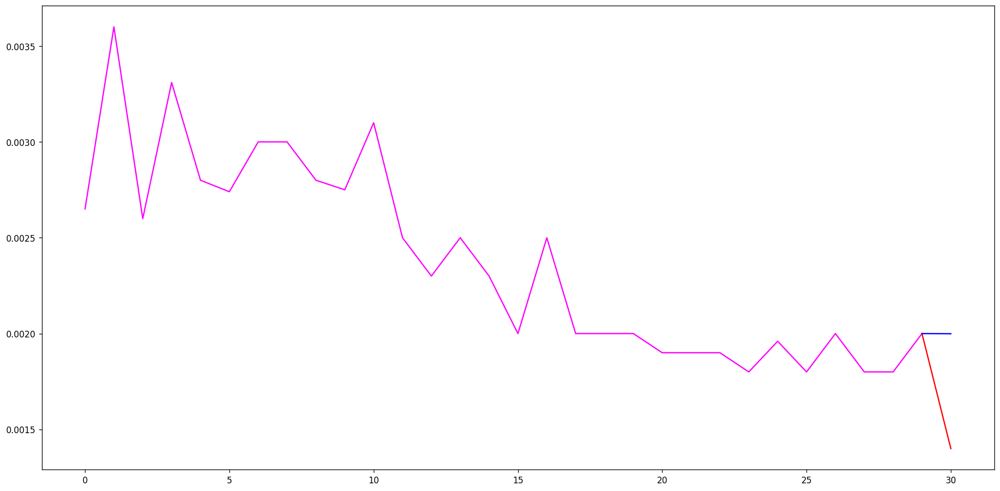

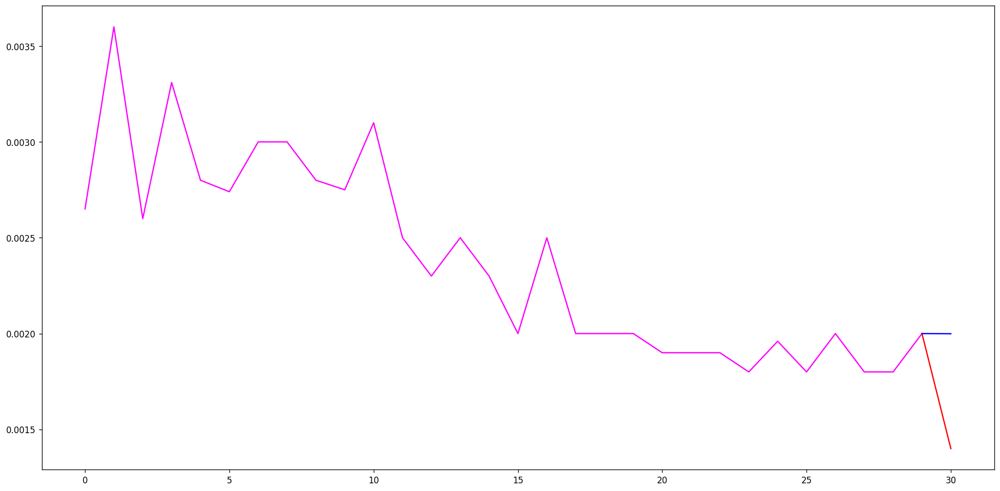

...

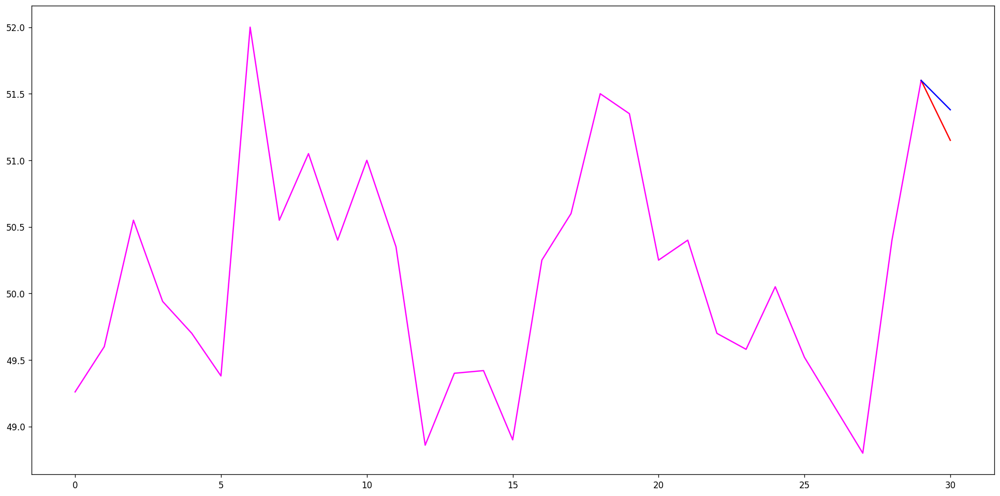

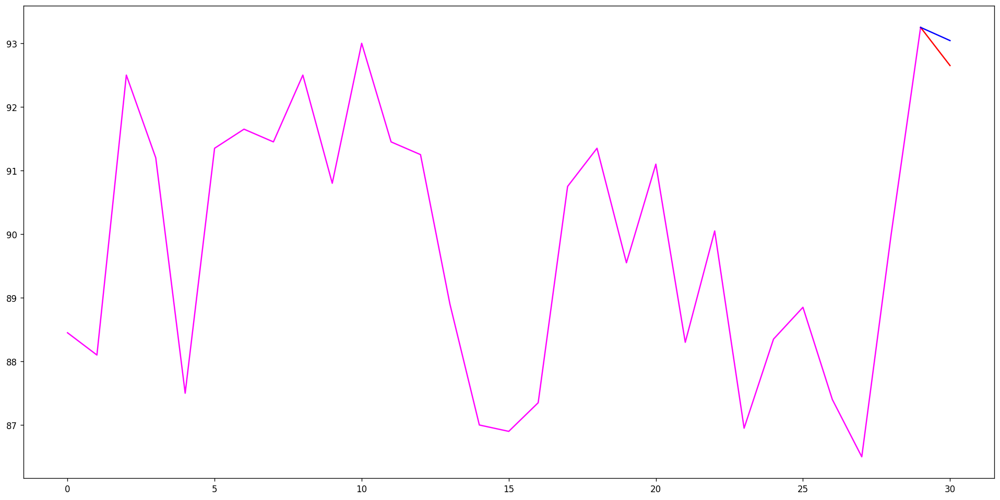

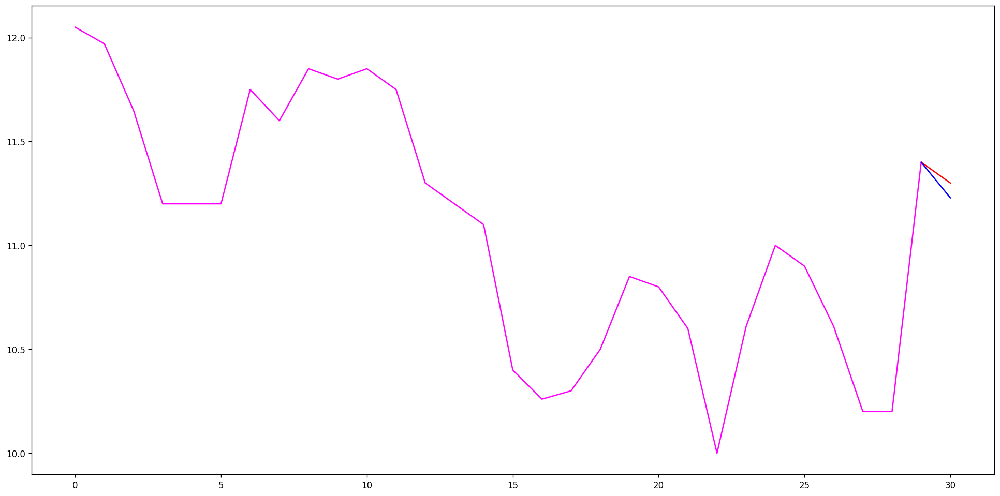

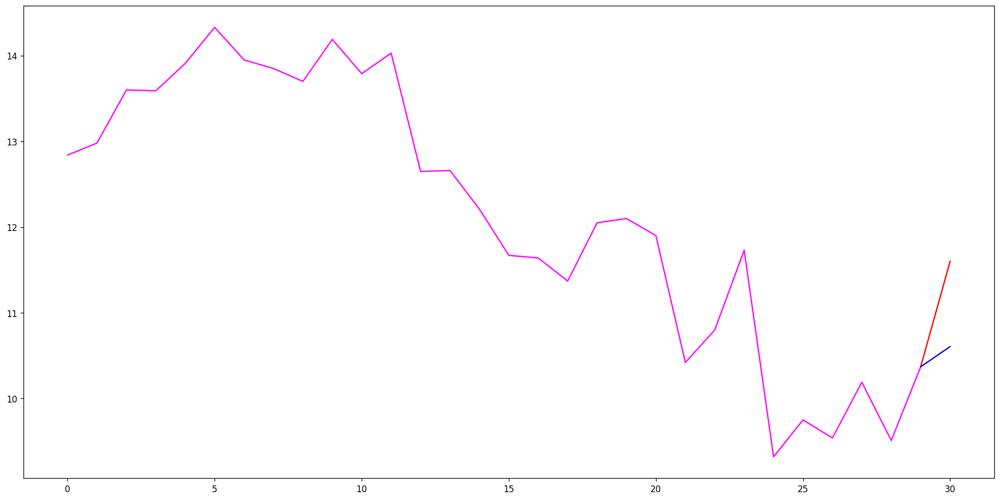

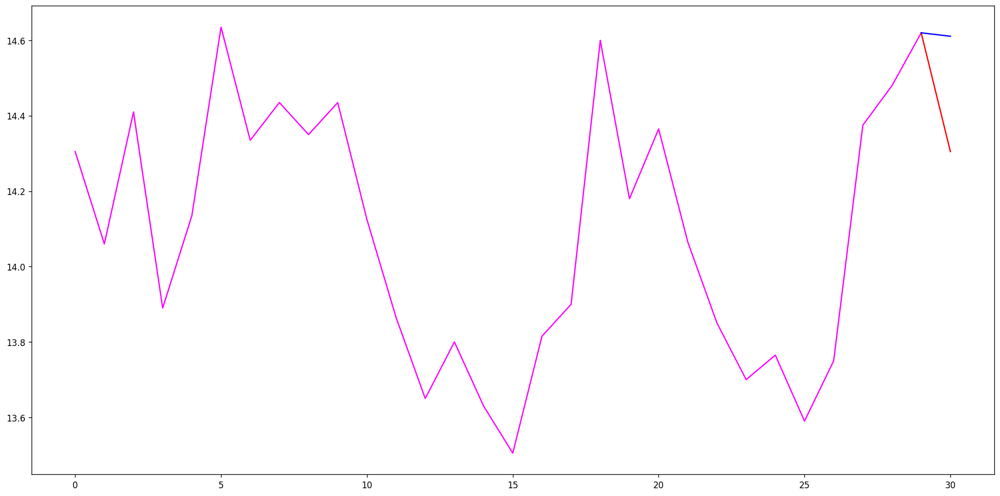

In [259]:
for i, (X_i, y_true_i, y_pred_i) in enumerate(zip(X_test, y_test, predicted_stock_price)):
    if (i > 100):
        break
    visualize_pred(X_i, y_true_i, y_pred_i)

## XGBoost model

### Build model

In [260]:
#@title Build model
seed = 100 #@param {type:"integer"}
n_estimators = 100 #@param {type:"integer"}
max_depth = 3 #@param {type:"integer"}
learning_rate = 0.1 #@param {type:"number"}
min_child_weight = 0 #@param {type:"number"}
subsample = 1 #@param {type:"number"}
colsample_bytree = 1 #@param {type:"number"}
colsample_bylevel = 1 #@param {type:"number"}
gamma = 0 #@param {type:"number"}
from xgboost import XGBRegressor

xgbmodel = XGBRegressor(seed=seed,
                        n_estimators=n_estimators,
                        max_depth=max_depth,
                        learning_rate=learning_rate,
                        min_child_weight=min_child_weight,
                        subsample=subsample,
                        colsample_bytree=colsample_bytree,
                        colsample_bylevel=colsample_bylevel,
                        gamma=gamma)

### Train the model

In [261]:
if scale_method != 'None':
    xgbmodel.fit(X_train_scaled[:, :, feature_pred_idx].reshape(X_train_scaled.shape[:2]), y_train_scaled)
else:
    xgbmodel.fit(X_train[:, :, feature_pred_idx].reshape(X_train.shape[:2]), y_train)

[08:22:07] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


### Test model

In [262]:
if scale_method != 'None':
    predicted_stock_price = xgbmodel.predict(X_test_scaled[:, :, feature_pred_idx].reshape(X_test_scaled.shape[:2]))
    predicted_stock_price = predicted_stock_price.reshape(-1, 1)
    predicted_stock_price = sc_test.inverse_transform(predicted_stock_price.T).T
else:
    predicted_stock_price = xgbmodel.predict(X_test[:, :, feature_pred_idx].reshape(X_test.shape[:2]))
    predicted_stock_price = predicted_stock_price.reshape(-1, 1)
# predicted_stock_price = xgbmodel.predict(np.reshape(X_test_scaled, (X_test_scaled.shape[0], X_test_scaled.shape[1])))
# predicted_stock_price = np.reshape(predicted_stock_price, (predicted_stock_price.shape[0], 1))
# if scale_method == 'MinMax':
#     predicted_stock_price = sc_test.inverse_transform(predicted_stock_price.T).T
    # y_test = sc_test.inverse_transform(y_test.T).T

In [263]:
# print(y_test)
# print(predicted_stock_price)

In [264]:
float_formatter = "{:.6f}".format
np.set_printoptions(formatter={'float_kind':float_formatter})
# print(y_test - predicted_stock_price)
# print(max(abs(y_test - predicted_stock_price)))
stats.describe(y_test - predicted_stock_price)

DescribeResult(nobs=509, minmax=(array([-486.568359]), array([1388.820312])), mean=array([0.755814]), variance=array([4597.764730]), skewness=array([16.031127]), kurtosis=array([349.197917]))

In [265]:
y_pred_label = y_preice_to_y_label(X_test, predicted_stock_price,
                                   min_change=min_price_change,
                                   feature_pred_idx=feature_pred_idx,
                                   num_classes=num_classes)
profit_multiple_pred_res = calc_profit_multiple(X_test, y_test, y_pred_label, min_price_change)
profit_multiple_pred = profit_multiple_pred_res[:, 0]
profit_margin_multiple_pred = profit_multiple_pred_res[:, 1]

if pattern_name == 'double_top':
    y_rush_label = np.zeros(y_pred_label.shape)
else:
    y_rush_label = np.ones(y_pred_label.shape)
profit_multiple_rush_res = calc_profit_multiple(X_test, y_test, y_rush_label, min_price_change)
profit_multiple_rush = profit_multiple_rush_res[:, 0]
profit_margin_multiple_rush = profit_multiple_rush_res[:, 1]

print(stats.describe(profit_multiple_pred))
print(stats.describe(profit_margin_multiple_pred))
print(stats.describe(profit_multiple_rush))
print(stats.describe(profit_margin_multiple_rush))

DescribeResult(nobs=509, minmax=(array([-103.959961]), array([637.464844])), mean=array([2.512168]), variance=array([1023.810091]), skewness=array([16.294515]), kurtosis=array([308.425391]))
DescribeResult(nobs=509, minmax=(array([0.500000]), array([1.516129])), mean=array([1.000466]), variance=array([0.006799]), skewness=array([0.863027]), kurtosis=array([18.022547]))
DescribeResult(nobs=509, minmax=(array([-637.464844]), array([187.792969])), mean=array([-0.626432]), variance=array([1029.740314]), skewness=array([-14.464160]), kurtosis=array([308.816081]))
DescribeResult(nobs=509, minmax=(array([0.483871]), array([1.500000])), mean=array([0.986187]), variance=array([0.006608]), skewness=array([-1.329873]), kurtosis=array([18.196798]))


rmse: 67.74439495764928 mape: 5.146021934214287
confusion_matrix: [[197 118]
 [118  76]]
acc: 0.5363457760314342


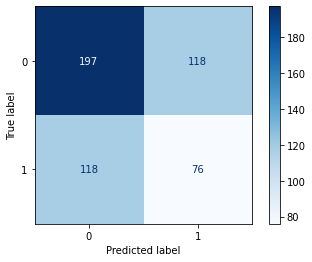

In [266]:
rmse = math.sqrt(mean_squared_error(y_test, predicted_stock_price))
mape = get_mape(y_test, predicted_stock_price)
conf_matrix = calc_confusion_matrix(X_test, y_test, predicted_stock_price, min_price_change)
acc = calc_accuracy(X_test, y_test, predicted_stock_price, min_price_change)

print('rmse:', rmse, 'mape:', mape)
print('confusion_matrix:', conf_matrix)
print('acc:', acc)

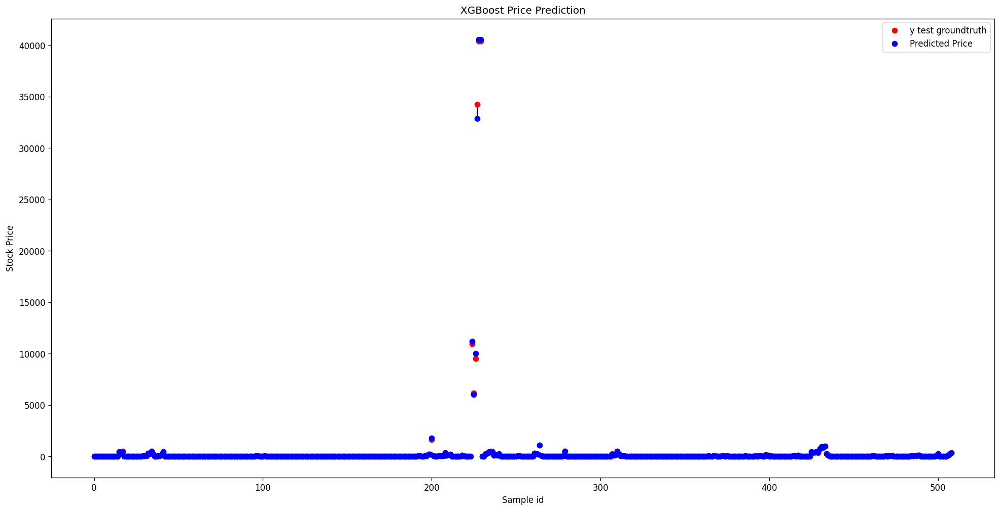

In [267]:
# Visualising the results
plt.figure(figsize=(20, 10), dpi= 120, facecolor='w', edgecolor='k')
plt.plot(range(len(y_test)), y_test, 'o', color = 'red', label = 'y test groundtruth')
plt.plot(range(len(y_test)), predicted_stock_price, 'o', color = 'blue', label = 'Predicted Price')
plt.vlines(range(len(y_test)), np.minimum(y_test, predicted_stock_price), np.maximum(y_test, predicted_stock_price))
# plt.xticks(np.arange(0,459,50))
plt.title('XGBoost Price Prediction')
plt.xlabel('Sample id')
plt.ylabel('Stock Price')
plt.legend()
plt.show()

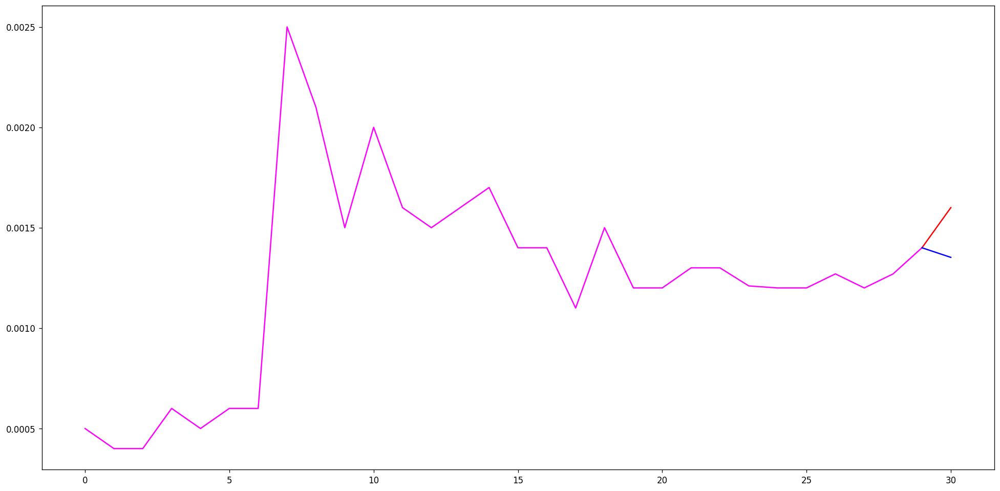

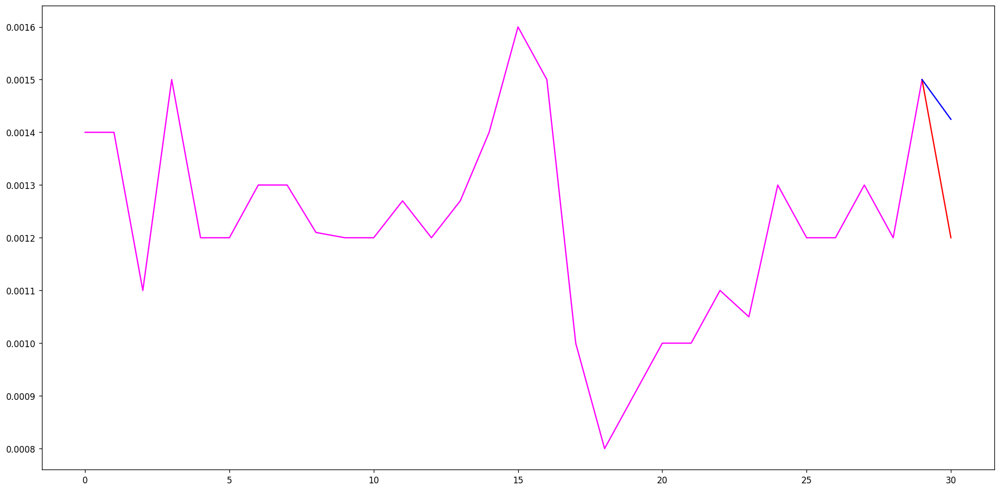

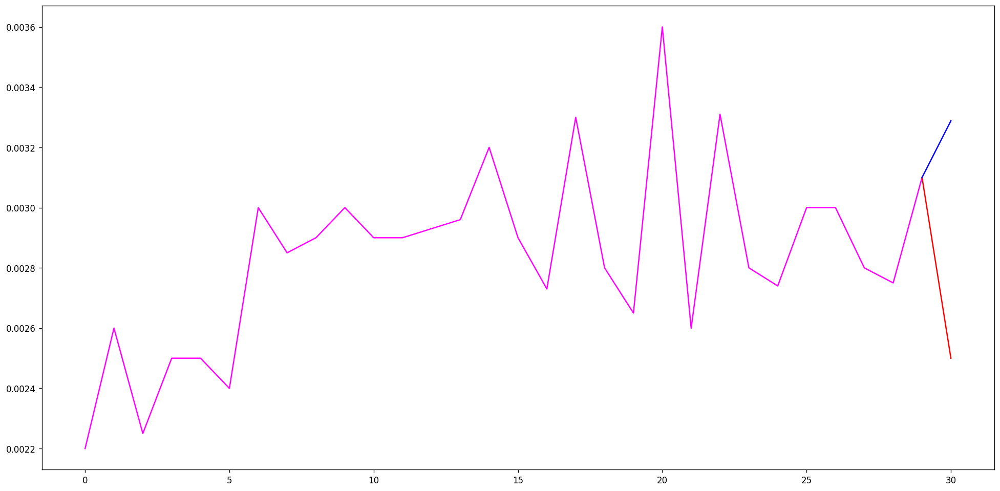

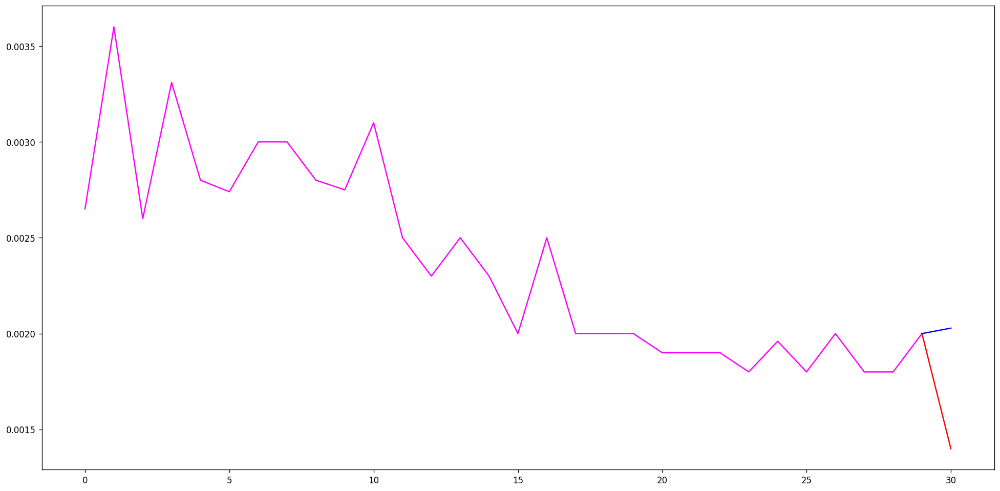

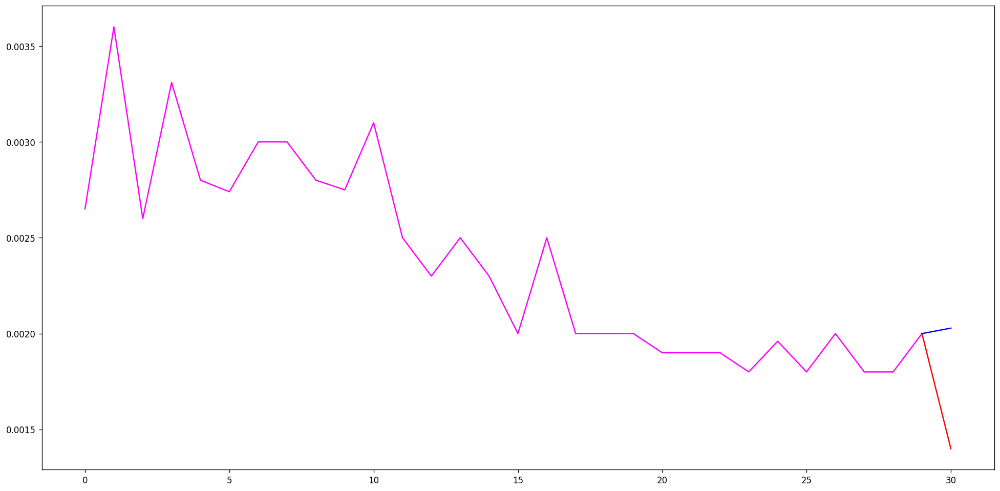

...

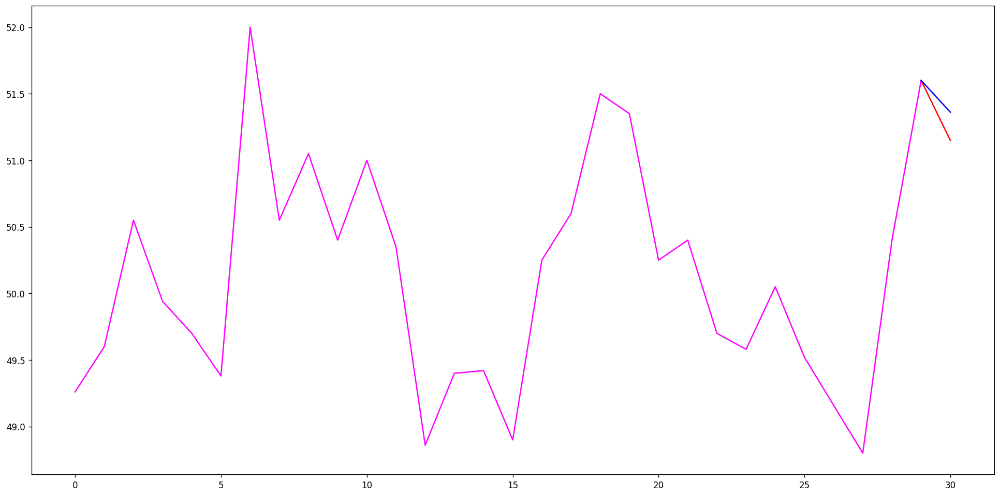

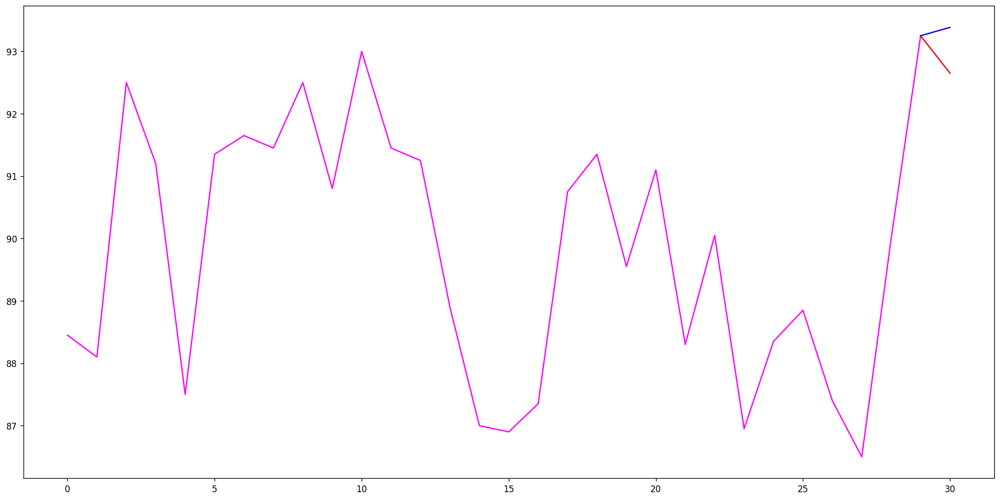

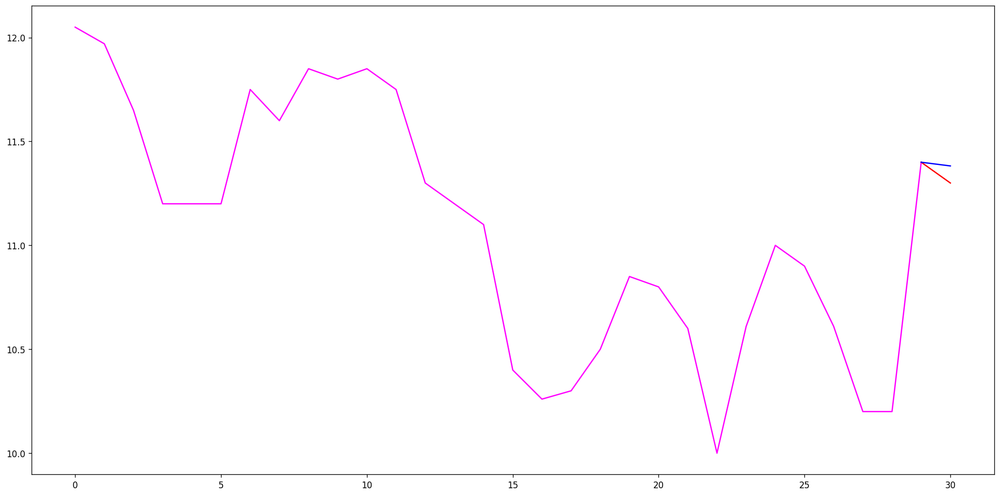

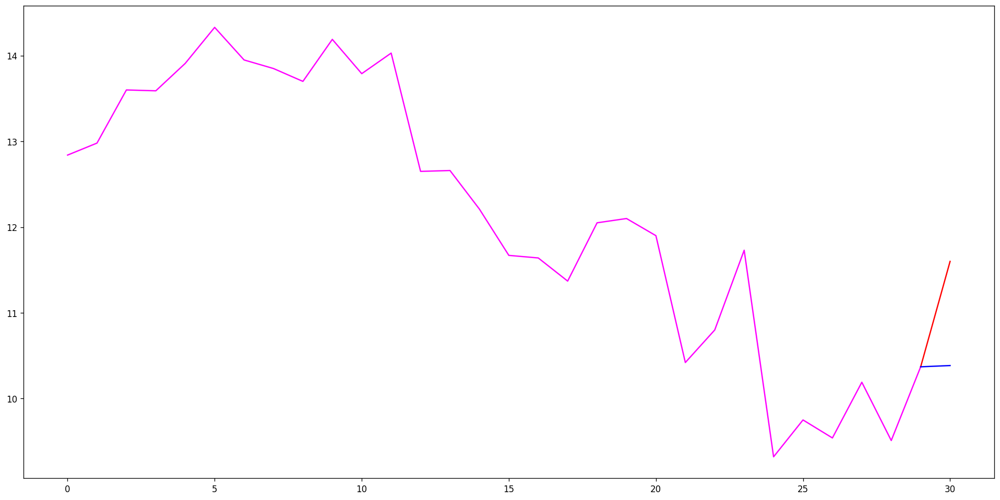

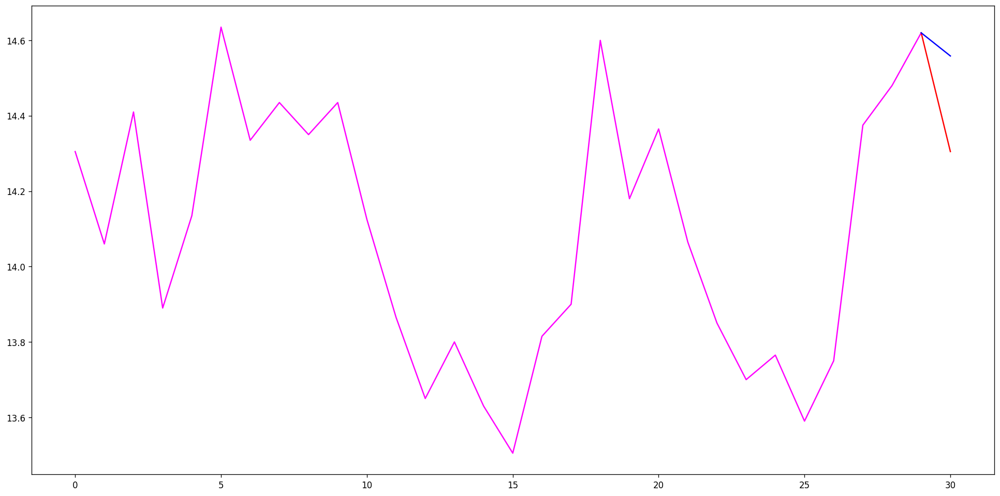

In [268]:
for i, (X_i, y_true_i, y_pred_i) in enumerate(zip(X_test, y_test, predicted_stock_price)):
    if (i > 100):
        break
    visualize_pred(X_i, y_true_i, y_pred_i)